In [1]:
# assign directory
import git
from pathlib import Path
import os
#from rembg import remove
ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from transform import *
from plotting import *
os.chdir(os.path.join(ROOT_DIR, "dataset-preparation"))

data_dir = data_dir = os.path.join(ROOT_DIR, 'raw-data','syntheticMRI2D','axial', 'toy-raw')
# iterate over files in that directory
file_list = [os.path.join(data_dir, filename) for filename in os.listdir(data_dir) if filename != ".DS_Store"]
file_names = os.listdir(data_dir)
LAYER_MAX = 8

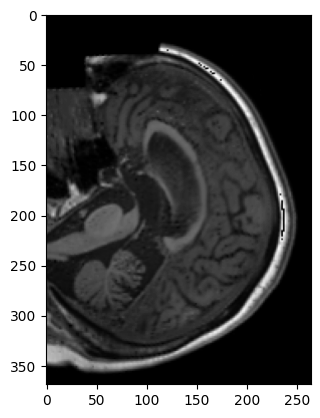

In [2]:
img = Image.open(file_list[2]).convert("L")
plt.imshow(img, cmap = "gray")

In [3]:
file_names[0]

'sub-002046-axial-slice.png'

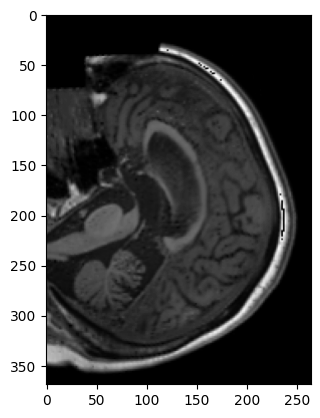

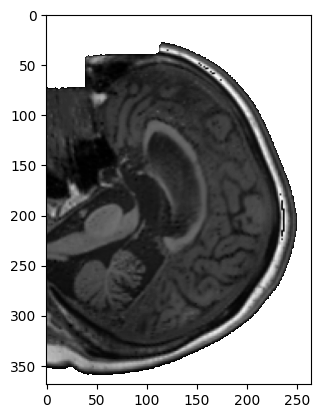

In [4]:
img = np.array(Image.open(file_list[2]).convert("L"))
img = img.astype(np.float16)
plt.imshow(img, cmap = "gray")
plt.show()
for j in range(img.shape[1]):
        for i in range(img.shape[0]-5):
            if np.sum(img[i:i+5, j] <= 7) >= 2:
                img[i, j] = np.nan
            else:
                break

for j in range(img.shape[1]):
    for i in range(img.shape[0]-1, 4, -1):  # Start from img.shape[0]-1 and go down to 5

        if np.any(np.isnan(img[i-5:i, j])):
            img[:,j] = np.nan
            break
        if np.sum(img[i-5:i, j] <= 7) >= 2:
            img[i, j] = np.nan
        else:
            break
for i in range(img.shape[0]):
    for j in range(img.shape[1]-1, 4, -1):  # Start from img.shape[0]-1 and go down to 5
        if np.sum(img[i, j:j-5] <= 7) >= 2:
            img[i, j] = np.nan
        else:
            break


plt.imshow(img, cmap="gray")
plt.show()


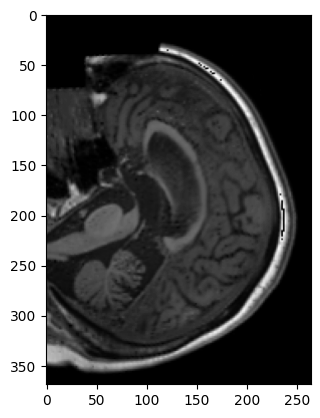

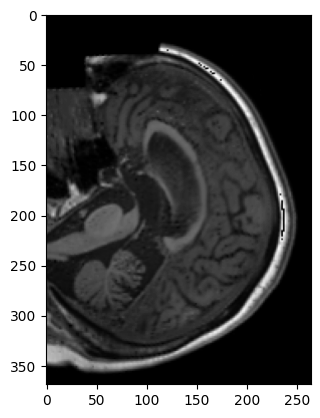

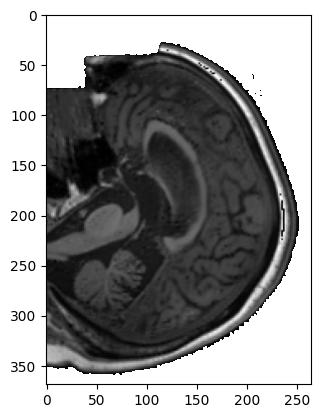

In [12]:
from scipy import ndimage

img = np.array(Image.open(file_list[2]).convert("L")).astype(np.float16)
plt.imshow(img, cmap="gray")
plt.show()
img_border = img.copy()
img_border[:, 0] = 100
plt.imshow(img_border, cmap="gray")
plt.show()
img_fill_holes = ndimage.binary_fill_holes(img_border).astype(int)
binary_mask = img_fill_holes == 0
img[binary_mask] = np.nan
plt.imshow(img, cmap="gray")
plt.show()

In [13]:
def filter_func_new(x):
    x_copy = x.copy()
    og_mask = np.array(remove(x_copy))[:,:,3]
    mask = og_mask.copy()
    mask[mask > 0] = 1
    float_mask = mask.astype(float)
    float_mask[mask == 0.0] = np.nan
    
    return float_mask*x_copy

In [14]:
def filter_func_force(x):
    img = x.copy().astype(np.float16)
    for j in range(img.shape[1]):
        for i in range(img.shape[0]-5):
            if np.sum(img[i:i+5, j] <= 7) >= 2:
                img[i, j] = np.nan
            else:
                break

    for j in range(img.shape[1]):
        for i in range(img.shape[0]-1, 4, -1):  # Start from img.shape[0]-1 and go down to 5

            if np.any(np.isnan(img[i-5:i, j])):
                img[:,j] = np.nan
                break
            if np.sum(img[i-5:i, j] <= 7) >= 2:
                img[i, j] = np.nan
            else:
                break
    for i in range(img.shape[0]):
        for j in range(img.shape[1]-1, 4, -1):  # Start from img.shape[0]-1 and go down to 5
            if np.sum(img[i, j:j-5] <= 7) >= 2:
                img[i, j] = np.nan
            else:
                break
    return img

In [15]:
def filter_func_best(x, dir = None):
    x_copy = x.copy().astype(np.float16)
    img_border = x_copy.copy()
    if dir == "left":
        img_border[:, 0] = 100
    elif dir == "right":
        img_border[:, -1] = 100
    elif dir == "top":
        img_border[0, :] = 100
    elif dir == "bottom":
        img_border[-1, :] = 100
    img_fill_holes = ndimage.binary_fill_holes(img_border).astype(int)
    binary_mask = img_fill_holes == 0
    x_copy[binary_mask] = np.nan
    return x_copy

In [16]:

filter_func_force(np.array(Image.open(file_list[2]).convert("L")))

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float16)

In [ ]:
for i in tqdm(range(len(file_list))):
    image = np.array(Image.open(file_list[i]).convert("L"))
    np.savez(os.path.join(ROOT_DIR, 'raw-data','syntheticMRI2D','axial', 'toy-cleaned', file_names[i][:-4]), filter_func_best(image, dir = "left"))
    #Image.fromarray(filter_func_force(image)).save(os.path.join(ROOT_DIR, 'raw-data','toy-syntheticMRI-2D','axial', 'cleaned', file_names[i][:-3]+"tiff"))

100%|██████████| 999/999 [00:13<00:00, 76.26it/s]


In [18]:
cleaned_data_dir = os.path.join(ROOT_DIR, 'raw-data','syntheticMRI2D','axial', 'toy-cleaned')
# iterate over files in that directory
file_list_cleaned = [os.path.join(cleaned_data_dir, filename) for filename in os.listdir(cleaned_data_dir) if filename != ".DS_Store"]
file_names_cleaned = os.listdir(cleaned_data_dir)

In [19]:
file_names_cleaned[0]

'sub-007641-axial-slice.npz'

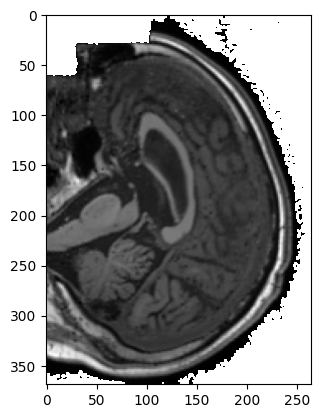

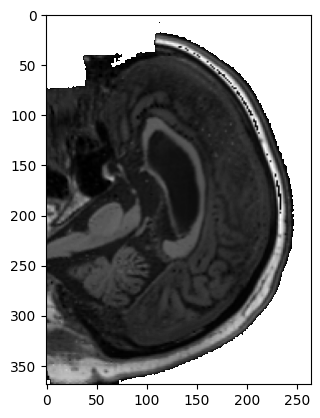

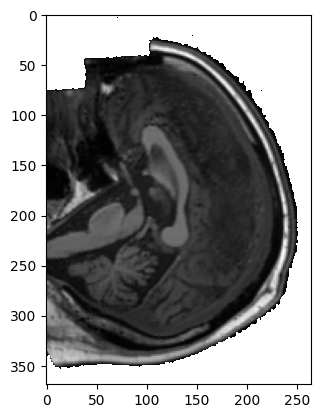

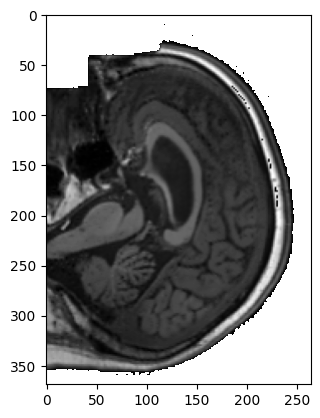

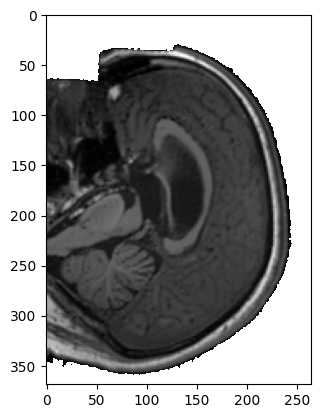

...

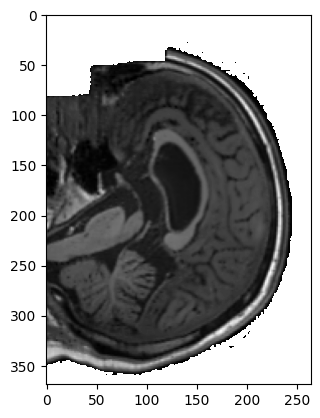

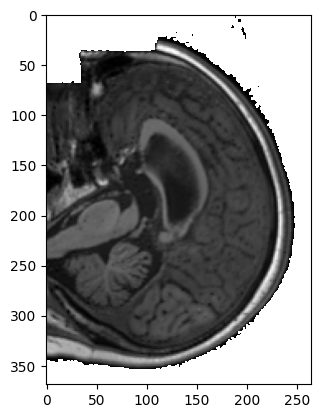

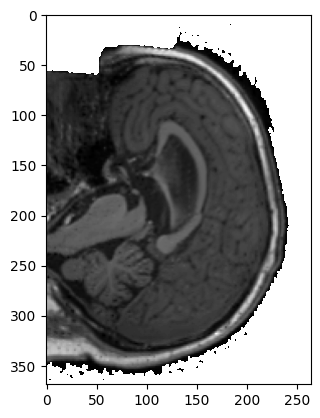

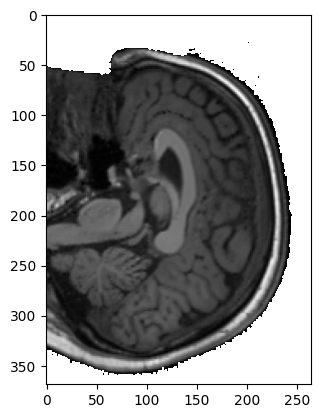

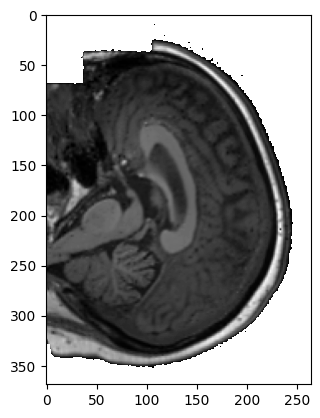

KeyboardInterrupt: 

In [20]:
for file in file_list_cleaned:
    image = npz_opener(file)
    plt.imshow(image, cmap = "gray")
    plt.show()